## 数据

In [1]:
%matplotlib inline
import sys
sys.path.append('..')
import matplotlib.pyplot as plt
from converter.utils import hdf5_reader
import numpy as np

In [2]:
def draw_contour(image,label,n):
  #image：原图  label:类别大小以数字区分  n：为器官数量
  colors = ['red','green','blue','orange','cyan','purple','pink','brown','olive','tomato','palegreen','crimson','indigo',\
           'turquoise','seagreen','lightskyblue','lime','sienna','moccasin','navy','orchid','peru','plum'] 
  plt.figure(figsize=(8,8))
  plt.axis('off')
  plt.imshow(image,'gray')
  final_labels =  np.zeros(label.shape + (n,), dtype=np.uint8)
  for z in range(n):
    final_labels[label==z+1,z]=1
  for i in range(n):
    if np.sum(final_labels[:,:,i]):
      plt.contour(final_labels[:,:,i],colors = colors[i])
  plt.savefig('./test.png')
  plt.show()
  plt.close()
    

In [3]:
def trunc_gray_and_normalize(img, in_range=(-1000, 600)):
    img = img - in_range[0]
    scale = in_range[1] - in_range[0]
    img[img < 0] = 0
    img[img > scale] = scale
    
    img = img / scale

    return img
    

In [4]:
from skimage.exposure.exposure import rescale_intensity
from skimage.draw import polygon
import cv2
import numpy as np
from skimage import measure


def get_body(image):
    
    def trunc_gray_and_normalize(img, in_range=(-1000, 600)):
        img = img - in_range[0]
        scale = in_range[1] - in_range[0]
        img[img < 0] = 0
        img[img > scale] = scale
        img = img / scale
        return img
    
    def post_seg(seg_result): 
        final_result = np.zeros_like(seg_result,dtype=np.uint8)           
        labels = measure.label(seg_result)
        area = []
        for j in range(1,np.amax(labels) + 1):
            area.append(np.sum(labels == j))
        if len(area) != 0:
            seg_result[np.logical_and(labels > 0, labels != np.argmax(area) + 1)] = 0
        final_result[seg_result == 1] = 1
        return final_result
    
    image = trunc_gray_and_normalize(image)
    body_array = np.zeros_like(image, dtype=np.uint8)
    for i in range(image.shape[0]):
        img = rescale_intensity(image[i], out_range=(0, 255))
        img = img.astype(np.uint8)
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
        body = cv2.erode(img, kernel, iterations=1)
        blur = cv2.GaussianBlur(body, (5, 5), 0)
        _, body = cv2.threshold(blur, 0, 1, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        body = cv2.morphologyEx(body, cv2.MORPH_CLOSE, kernel, iterations=3)
        contours, _ = cv2.findContours(body, cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
        area = [[c, cv2.contourArea(contours[c])] for c in range(len(contours))]
        area.sort(key=lambda x: x[1], reverse=True)
        body = np.zeros_like(body, dtype=np.uint8)
        for j in range(min(len(area),3)):
            if area[j][1] > area[0][1] / 20:
                contour = contours[area[j][0]]
                r = contour[:, 0, 1]
                c = contour[:, 0, 0]
                rr, cc = polygon(r, c)
                body[rr, cc] = 1
        body_array[i] = cv2.medianBlur(body, 5)

    return post_seg(body_array)

# 3D data

In [19]:
# path = '/staff/shijun/dataset/Med_Seg/Cervical_Oar/3d_data/190094.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Nasopharynx_Oar/npy_data/190510.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Covid-Seg/npy_data/0016.hdf5'
# path = '/acsa-med/radiology/Med_Seg/Lung_Oar/npy_data/190855.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Lung_Tumor/npy_data/01472680.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/EGFR/npy_data/0101.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Lung_Tumor/npy_data/missing20/0009370744.hdf5'
# path = '/acsa-med/radiology/Med_Seg/LIDC/npy_data/LIDC-IDRI-0751.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/LITS/npy_data/28.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Structseg_HaN/npy_data/30.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Structseg_THOR/npy_data/30.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Nasopharynx_Tumor/npy_data/009273.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Cervical_Tumor/npy_data/161400.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/SegTHOR/npy_data/Patient_29.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/HaN_GTV/npy_data/30.hdf5'
path = '/staff/shijun/dataset/Med_Seg/Thor_GTV/npy_data/30.hdf5'
img = hdf5_reader(path,'image')
lab = hdf5_reader(path,'label')

print(img.shape)
print(lab.shape)
print(np.sum(lab))

print(np.unique(lab))

new_label = np.zeros((np.max(np.unique(lab).astype(np.uint8)) + 1,) + lab.shape, dtype=np.float32)
for z in list(np.unique(lab).astype(np.uint8)):
    if z !=0:
        temp = (lab==z).astype(np.float32)
        new_label[z,...] = temp
new_label[0,...] = np.amax(new_label[1:,...],axis=0) == 0   
img = trunc_gray_and_normalize(img,(-800,400))



(107, 512, 512)
(107, 512, 512)
10534.0
[0. 1.]


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46


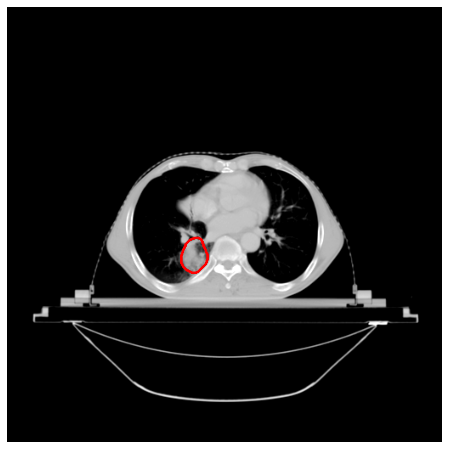

47


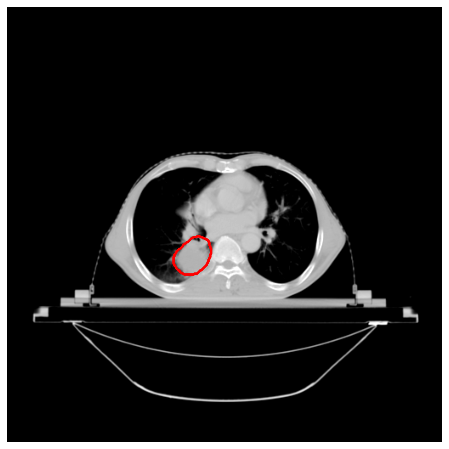

48


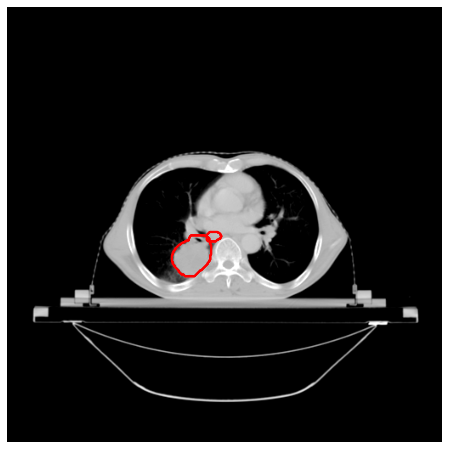

49


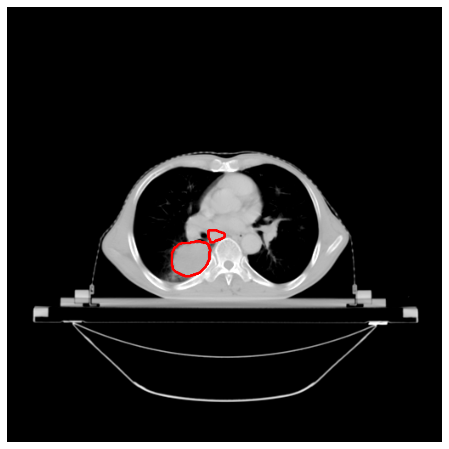

50


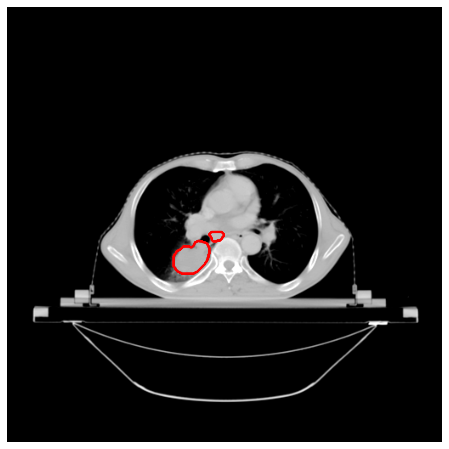

51


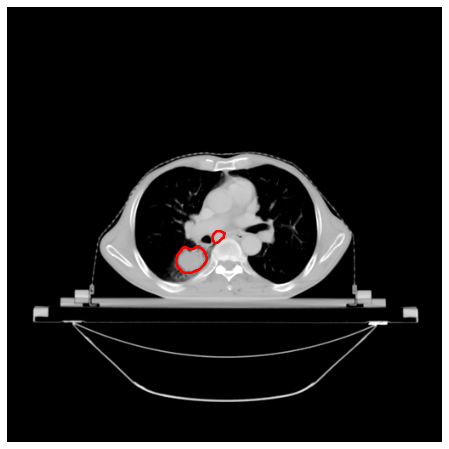

52


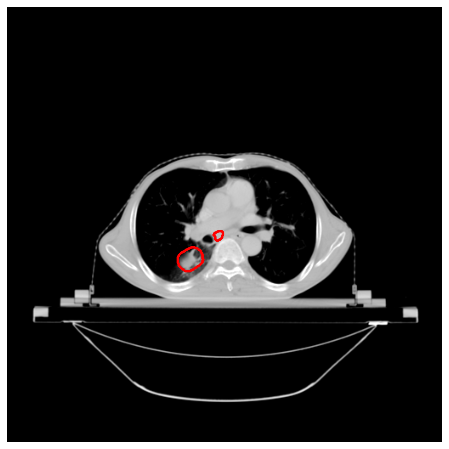

53


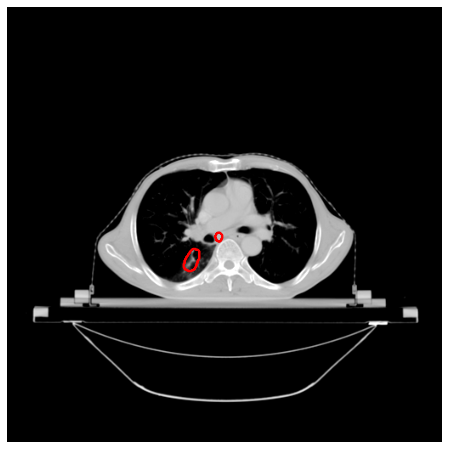

54


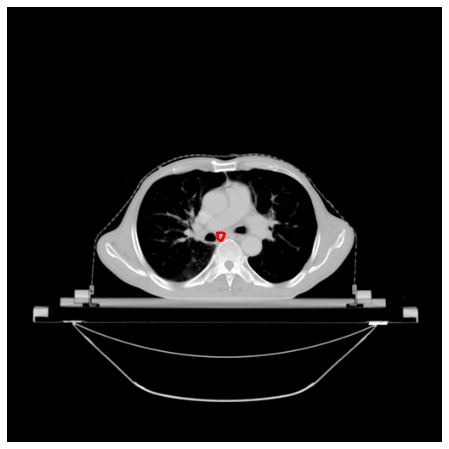

55


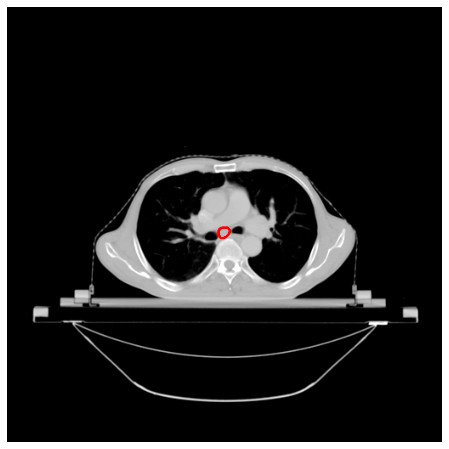

56


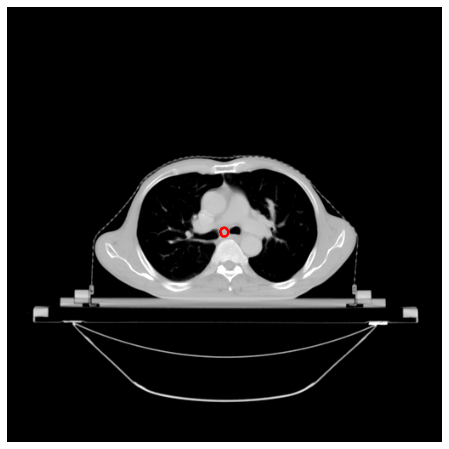

57
58
59
60
61
62
63


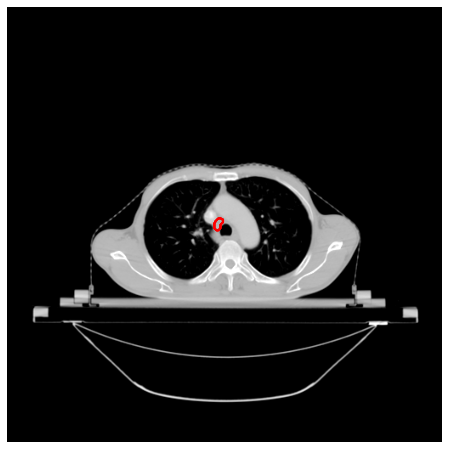

64


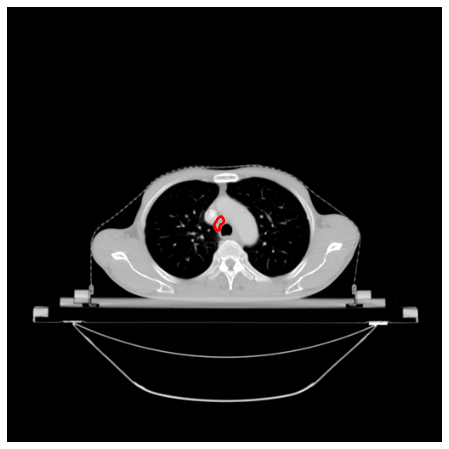

65


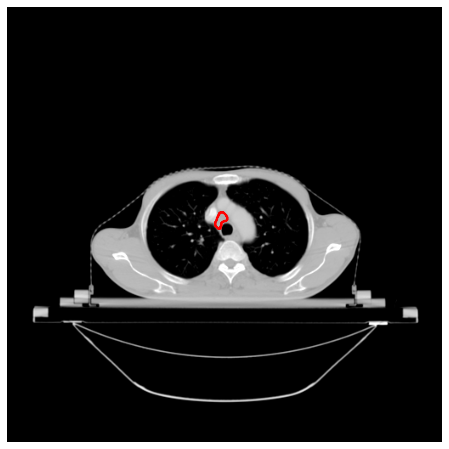

66


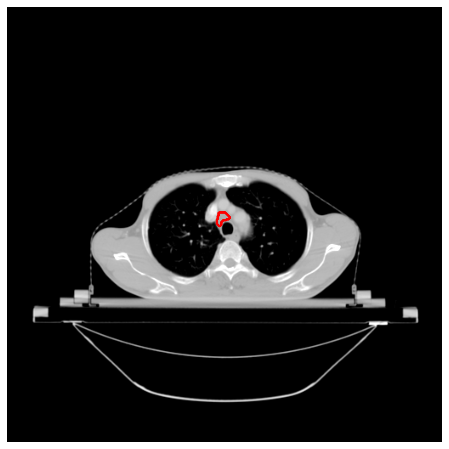

67


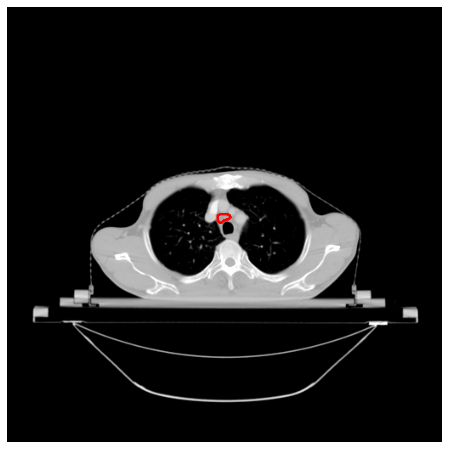

68


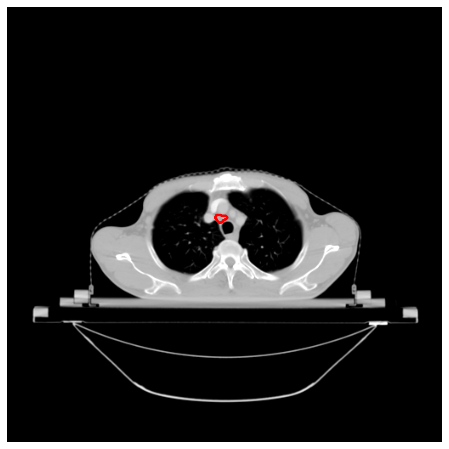

69
70


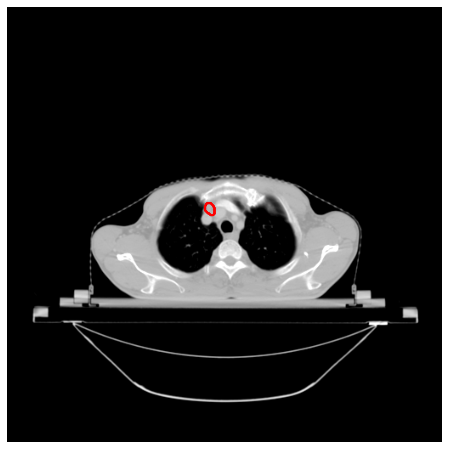

71


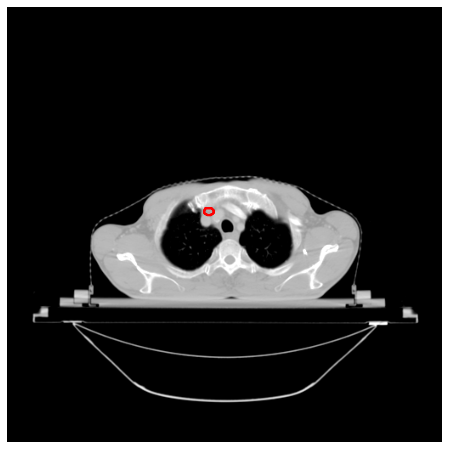

72


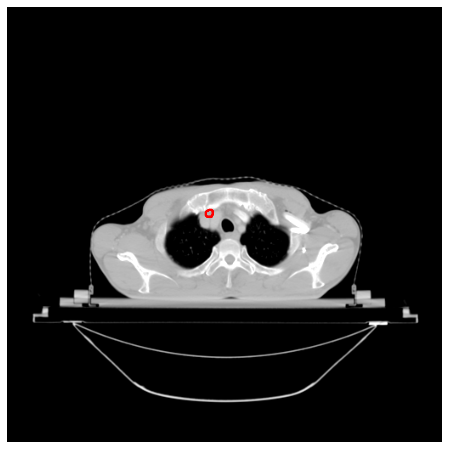

73


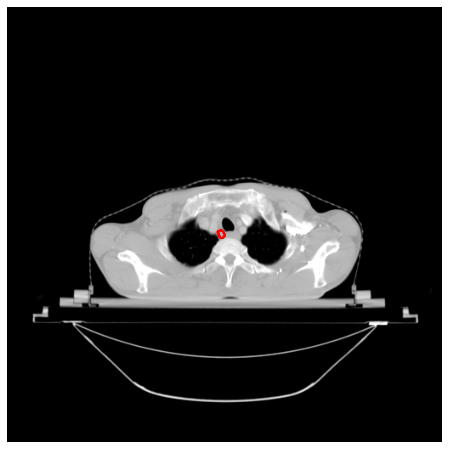

74


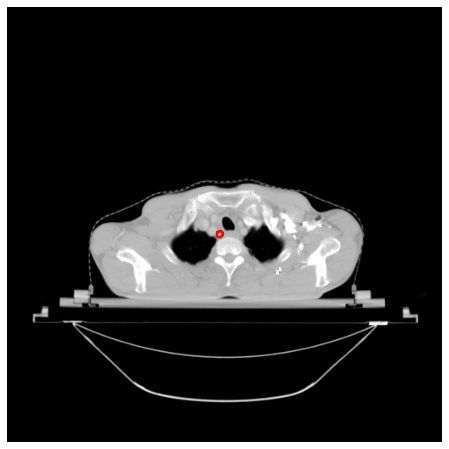

75


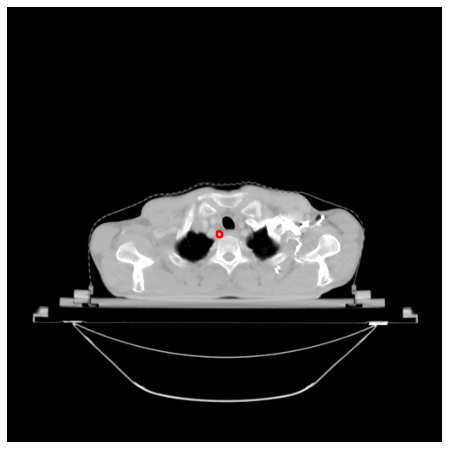

76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106


In [20]:
for i in range(img.shape[0]):
    print(i)
    if np.sum(lab[i])!=0:
        draw_contour(img[i],lab[i],22)

In [50]:
path = '/acsa-med/radiology/Med_Seg/LIDC/new_npy_data/LIDC-IDRI-0751.hdf5'
img = hdf5_reader(path,'image')
lab = hdf5_reader(path,'label')

print(img.shape)
print(lab.shape)
print(np.sum(lab))

print(np.unique(lab))

new_label = np.zeros((np.max(np.unique(lab).astype(np.uint8)) + 1,) + lab.shape, dtype=np.float32)
for z in list(np.unique(lab).astype(np.uint8)):
    if z !=0:
        temp = (lab==z).astype(np.float32)
        new_label[z,...] = temp
new_label[0,...] = np.amax(new_label[1:,...],axis=0) == 0   

(119, 512, 512)
(119, 512, 512)
15483.0
[0. 1.]


# 2D data

3071.0 -1024.0
[0. 1.]


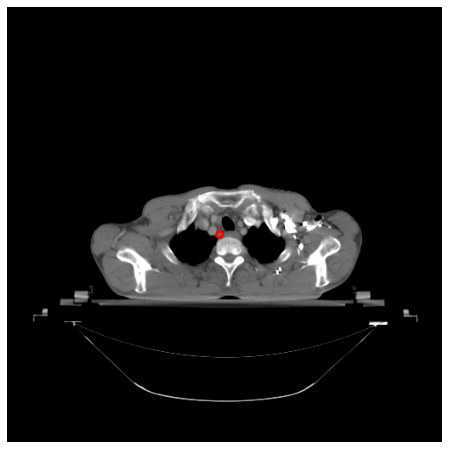

In [12]:
import os

# path = '/staff/shijun/dataset/Med_Seg/Cervical_Oar/2d_test_data/171372_54.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Covid-Seg/2d_data/0110_35.hdf5'
# path = '/acsa-med/radiology/Med_Seg/Lung_Oar/2d_data/190855_33.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Lung_Tumor/2d_data/08676580_306.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Nasopharynx_Oar/2d_data/191681_50.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/EGFR/2d_data/0101_24.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/LIDC/2d_data/LIDC-IDRI-0339_238.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/SegTHOR/2d_data/Patient_29_103.hdf5'
path = '/staff/shijun/dataset/Med_Seg/Thor_GTV/2d_data/30_74.hdf5'


img = hdf5_reader(path,'image')
lab = hdf5_reader(path,'label')
#     print(img.shape)
#     print(lab.shape)

print(np.max(img),np.min(img))

# cv_img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)

print(np.unique(lab))

for z in np.unique(lab):
    if z != 0:
        tmp_img = trunc_gray_and_normalize(img,[-200,400])
#         tmp_img = img
        draw_contour(tmp_img,(lab==z).astype(np.float32),18)

In [ ]:
import os
# path = '/staff/shijun/dataset/Med_Seg/Cervical_Oar/2d_data/160759_46.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Covid-Seg/2d_data/0473_20.hdf5'
# path = '/acsa-med/radiology/Med_Seg/Lung_Oar/2d_data/190855_35.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Lung_Tumor/2d_data/'
# path = '/staff/shijun/dataset/Med_Seg/Nasopharynx_Oar/2d_data/190510_80.hdf5'
path = '/staff/shijun/dataset/Med_Seg/EGFR/2d_data/'

for item in os.scandir(path):

    img = hdf5_reader(item.path,'image')
    lab = hdf5_reader(item.path,'label')
#     print(img.shape)
#     print(lab.shape)

#     print(np.unique(lab))

    for z in np.unique(lab):
        if z != 0:
            tmp_img = trunc_gray_and_normalize(img,[-1100,500])
            draw_contour(tmp_img,(lab==z).astype(np.float32),18)

0.049719848 1.0


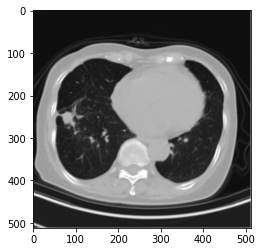

(512, 512)
726


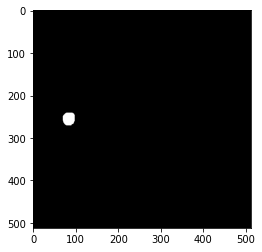

In [27]:
from PIL import Image
print(np.min(tmp_img),np.max(tmp_img))
pil_img = Image.fromarray(tmp_img*255).convert('RGB')
plt.imshow(pil_img)
plt.show()

print(tmp_img.shape)

print(np.sum((lab==z)))
pil_lab = Image.fromarray((lab==z).astype(np.uint8),mode='L')
plt.imshow(pil_lab,'gray')
plt.show()

##  SegTHOR

In [6]:
import os
path = '/staff/shijun/dataset/Med_Seg/SegTHOR/2d_data/'


for item in os.scandir(path):
    img = hdf5_reader(item.path,'image')
    lab = hdf5_reader(item.path,'label')

    print(np.unique(lab))

    for z in np.unique(lab):
        #if z != 0 and z != 3:
        if z == 1:
            tmp_img = trunc_gray_and_normalize(img,[-800,400])
            draw_contour(tmp_img,(lab==z).astype(np.float32),18)
    

NotADirectoryError: [Errno 20] Not a directory: '/staff/shijun/dataset/Med_Seg/SegTHOR/2d_data/Patient_29_103.hdf5'

## LIDC

[0. 1.]
0
1


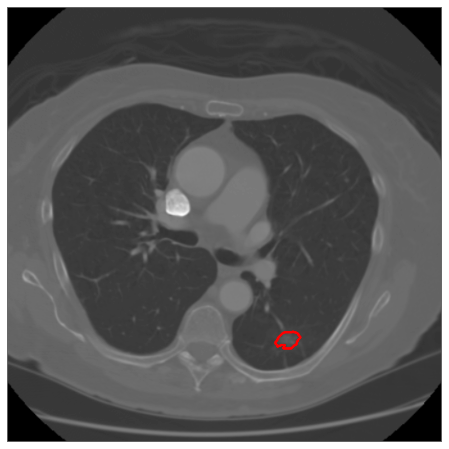

[0. 1.]
0
1


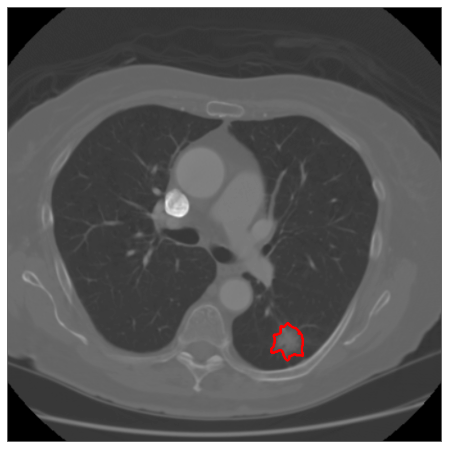

[0. 1.]
0
1


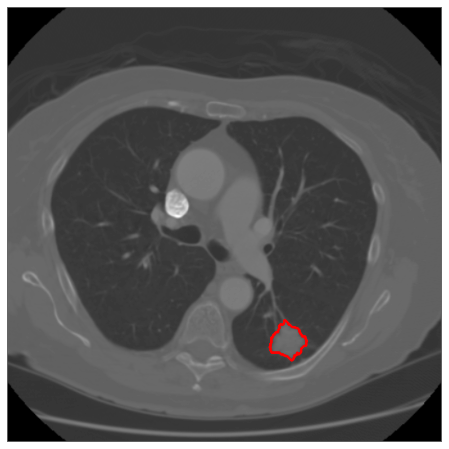

[0. 1.]
0
1


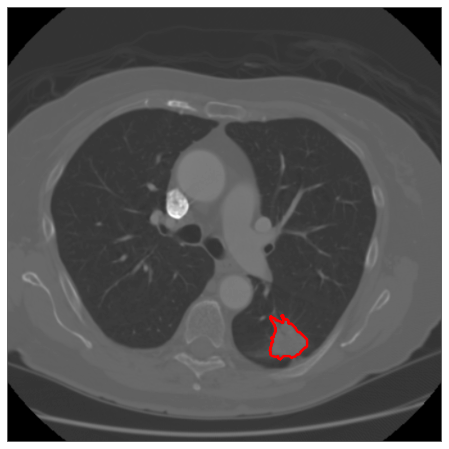

[0. 1.]
0
1


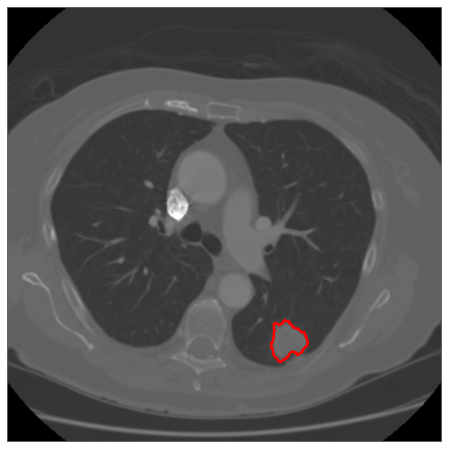

[0. 1.]
0
1


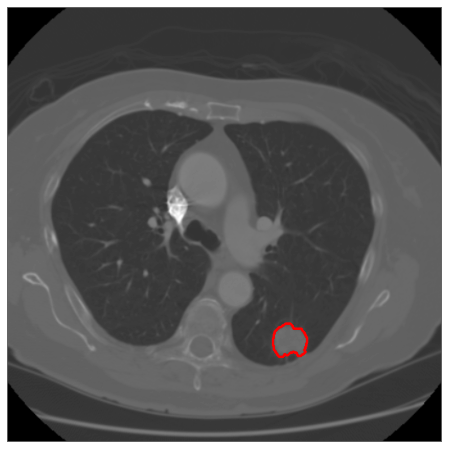

[0. 1.]
0
1


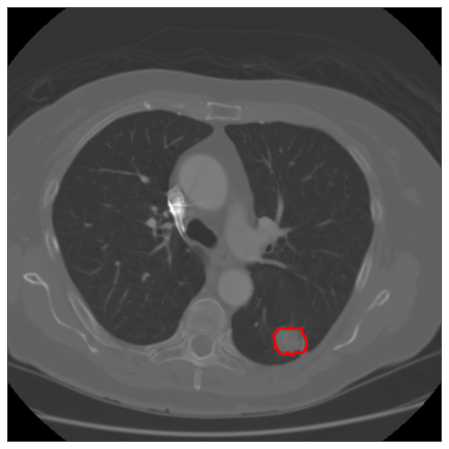

[0. 1.]
0
1


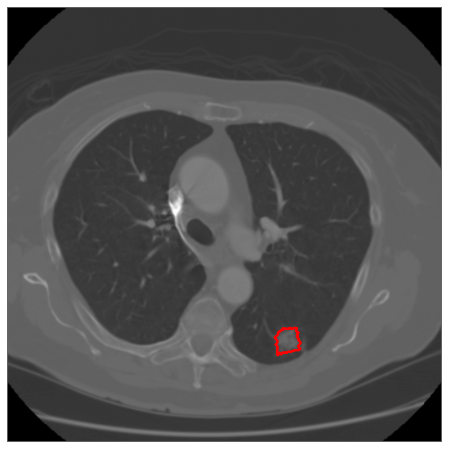

[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0
[0.]
0


In [11]:
import os
root_path = '/staff/shijun/dataset/Med_Seg/LIDC/2d_data/LIDC-IDRI-0001_'

for i in range(86,133):
    path = root_path + str(i) + '.hdf5'
    img = hdf5_reader(path,'image')
    lab = hdf5_reader(path,'label')

    print(np.unique(lab))

    for z in np.unique(lab).astype(np.uint8):
        print(z)
        if z != 0:
            tmp_img = trunc_gray_and_normalize(img,[-800,400])
            tmp_img = img
            draw_contour(tmp_img,(lab==z).astype(np.float32),18)

0
[0.]
1
[0.]
2
[0.]
3
[0.]
4
[0.]
5
[0.]
6
[0.]
7
[0.]
8
[0.]
9
[0.]
10
[0.]
11
[0.]
12
[0.]
13
[0.]
14
[0.]
15
[0.]
16
[0.]
17
[0.]
18
[0.]
19
[0.]
20
[0.]
21
[0.]
22
[0.]
23
[0.]
24
[0.]
25
[0.]
26
[0.]
27
[0.]
28
[0.]
29
[0.]
30
[0.]
31
[0.]
32
[0.]
33
[0.]
34
[0.]
35
[0.]
36
[0.]
37
[0.]
38
[0.]
39
[0.]
40
[0.]
41
[0.]
42
[0.]
43
[0.]
44
[0.]
45
[0.]
46
[0.]
47
[0.]
48
[0.]
49
[0.]
50
[0.]
51
[0.]
52
[0.]
53
[0.]
54
[0.]
55
[0.]
56
[0.]
57
[0.]
58
[0.]
59
[0.]
60
[0.]
61
[0.]
62
[0.]
63
[0.]
64
[0.]
65
[0.]
66
[0.]
67
[0.]
68
[0.]
69
[0.]
70
[0.]
71
[0.]
72
[0.]
73
[0.]
74
[0.]
75
[0.]
76
[0.]
77
[0.]
78
[0.]
79
[0.]
80
[0.]
81
[0.]
82
[0.]
83
[0.]
84
[0.]
85
[0.]
86
[0. 1.]
1


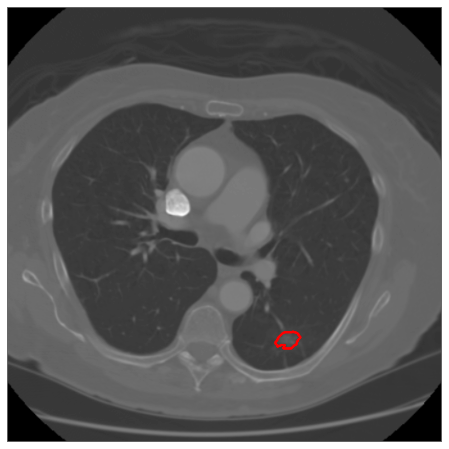

87
[0. 1.]
1


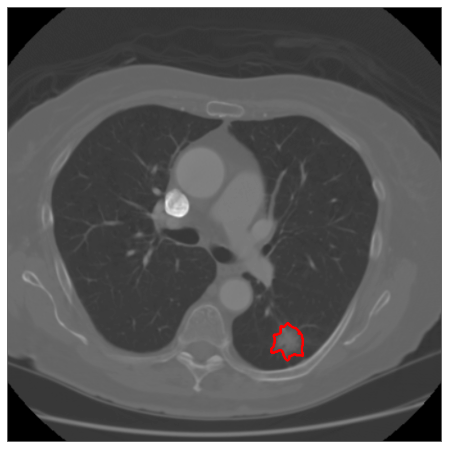

88
[0. 1.]
1


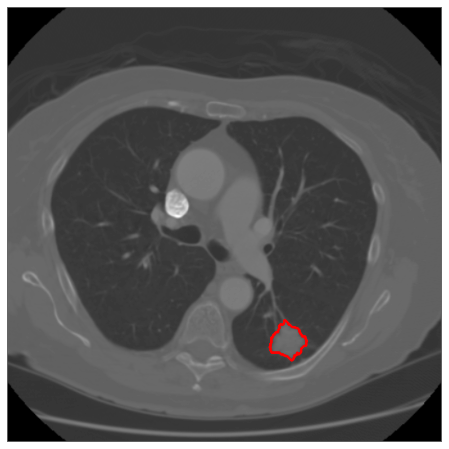

89
[0. 1.]
1


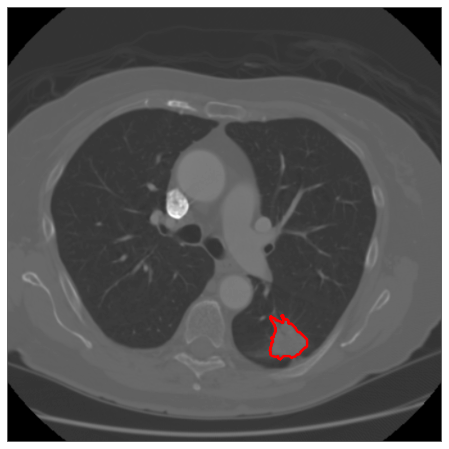

90
[0. 1.]
1


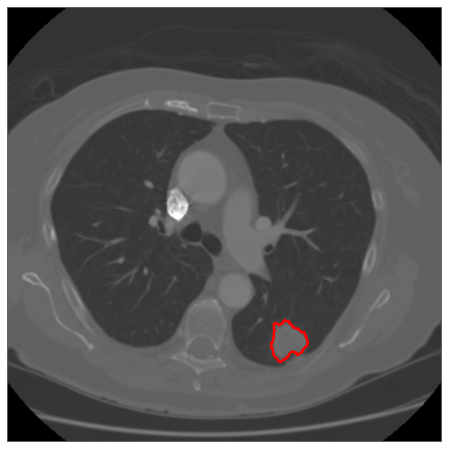

91
[0. 1.]
1


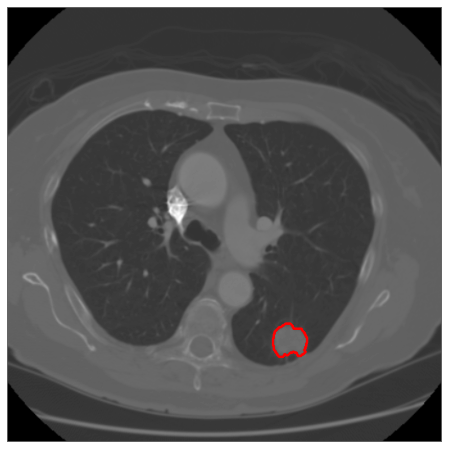

92
[0. 1.]
1


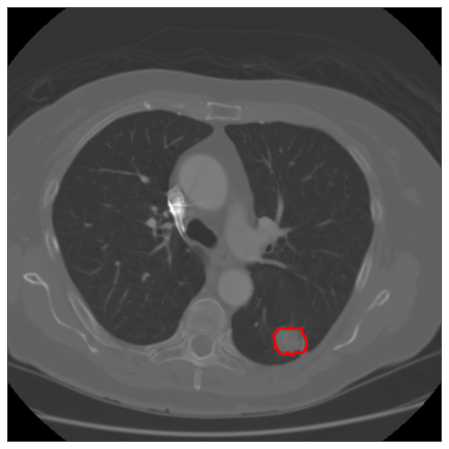

93
[0. 1.]
1


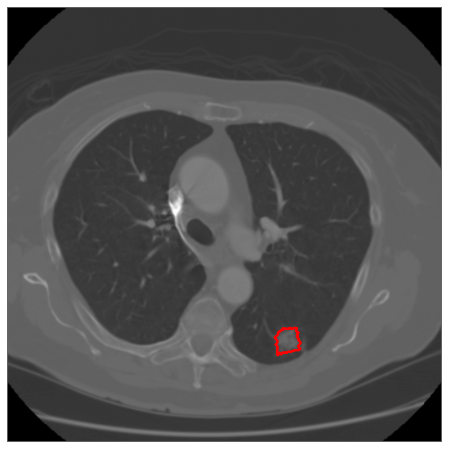

94
[0.]
95
[0.]
96
[0.]
97
[0.]
98
[0.]
99
[0.]
100
[0.]
101
[0.]
102
[0.]
103
[0.]
104
[0.]
105
[0.]
106
[0.]
107
[0.]
108
[0.]
109
[0.]
110
[0.]
111
[0.]
112
[0.]
113
[0.]
114
[0.]
115
[0.]
116
[0.]
117
[0.]
118
[0.]
119
[0.]
120
[0.]
121
[0.]
122
[0.]
123
[0.]
124
[0.]
125
[0.]
126
[0.]
127
[0.]
128
[0.]
129
[0.]
130
[0.]
131
[0.]
132
[0.]


In [41]:
import os
root_path = '/staff/shijun/dataset/Med_Seg/LIDC/2d_test_data/LIDC-IDRI-0001_'

for i in range(133):
    print(i)
    path = root_path + str(i) + '.hdf5'
    img = hdf5_reader(path,'image')
    lab = hdf5_reader(path,'label')

    print(np.unique(lab))

    for z in np.unique(lab).astype(np.uint8):
        if z != 0:
            print(z)
    #         tmp_img = trunc_gray_and_normalize(img,[-800,400])
            tmp_img = img
            draw_contour(tmp_img,(lab==z).astype(np.float32),18)

# Get Body

In [22]:
from skimage.exposure.exposure import rescale_intensity
from skimage.draw import polygon
import cv2
import numpy as np
from skimage import measure
from multiprocessing import Pool

def get_body_singe(image,label):
    img = rescale_intensity(image, out_range=(0, 255))
    img = img.astype(np.uint8)
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    body = cv2.erode(img, kernel, iterations=1)
    blur = cv2.GaussianBlur(body, (5, 5), 0)
    _, body = cv2.threshold(blur, 0, 1, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    body = cv2.morphologyEx(body, cv2.MORPH_CLOSE, kernel, iterations=3)
    contours, _ = cv2.findContours(body, cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    area = [[i, cv2.contourArea(contours[i])] for i in range(len(contours))]
    area.sort(key=lambda x: x[1], reverse=True)
    body = np.zeros_like(body, dtype=np.uint8)
    for j in range(min(len(area),3)):
        if area[j][1] > area[0][1] / 20:
            contour = contours[area[j][0]]
            r = contour[:, 0, 1]
            c = contour[:, 0, 0]
            rr, cc = polygon(r, c)
            body[rr, cc] = 1
    label = cv2.medianBlur(body, 5)


def get_body(image):
    
    def trunc_gray_and_normalize(img, in_range=(-1000, 600)):
        img = img - in_range[0]
        scale = in_range[1] - in_range[0]
        img[img < 0] = 0
        img[img > scale] = scale
        img = img / scale
        return img
    
    def post_seg(seg_result): 
        final_result = np.zeros_like(seg_result,dtype=np.uint8)           
        labels = measure.label(seg_result)
        area = []
        for j in range(1,np.amax(labels) + 1):
            area.append(np.sum(labels == j))
        if len(area) != 0:
            seg_result[np.logical_and(labels > 0, labels != np.argmax(area) + 1)] = 0
        final_result[seg_result == 1] = 1
        return final_result
    
    
    image = trunc_gray_and_normalize(image)
    body_array = np.zeros_like(image, dtype=np.uint8)
    pool = Pool(10)
    for i in range(image.shape[0]):
        pool.apply_async(get_body_singe, (image[i],body_array[i]))
    pool.close()
    pool.join()
    print(image.dtype)

    return post_seg(body_array)


int32
float64
run time: 4.694


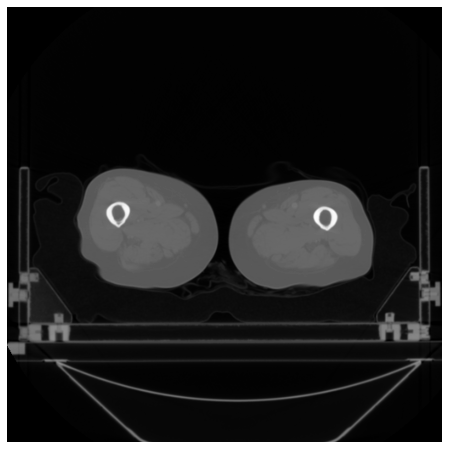

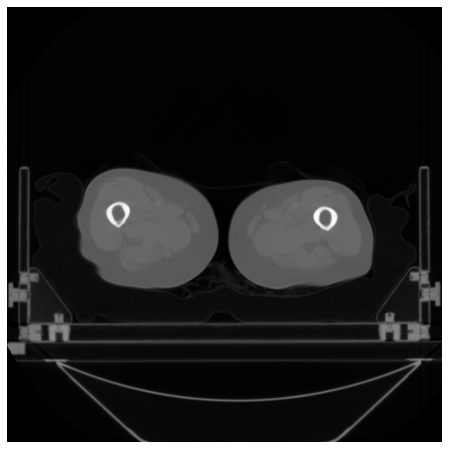

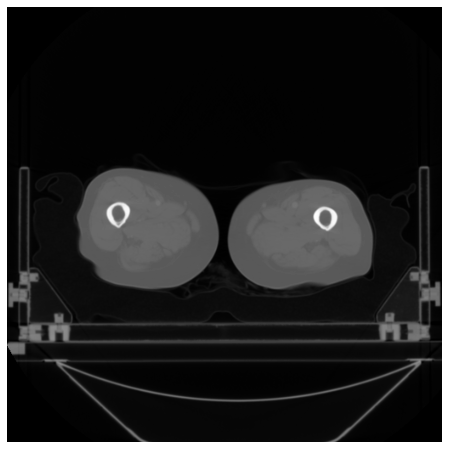

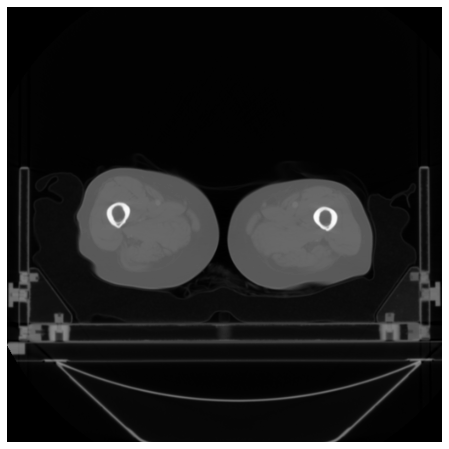

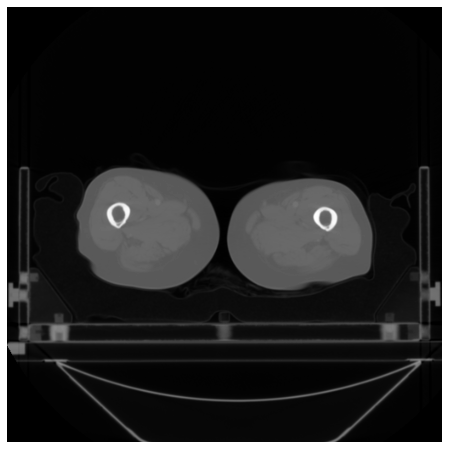

...

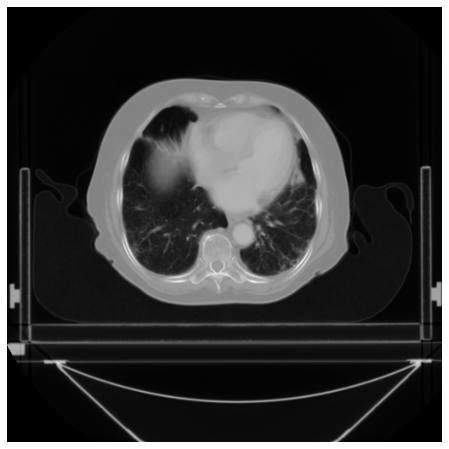

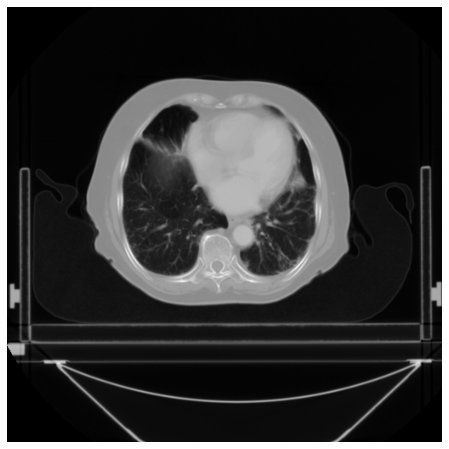

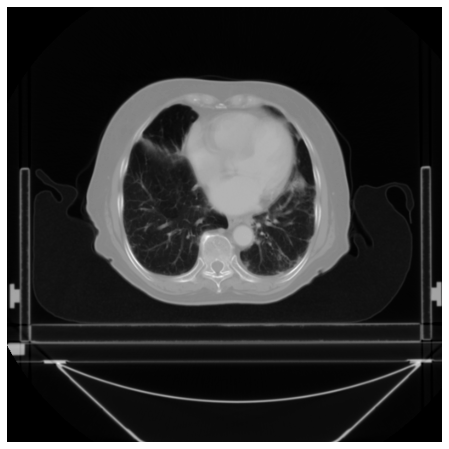

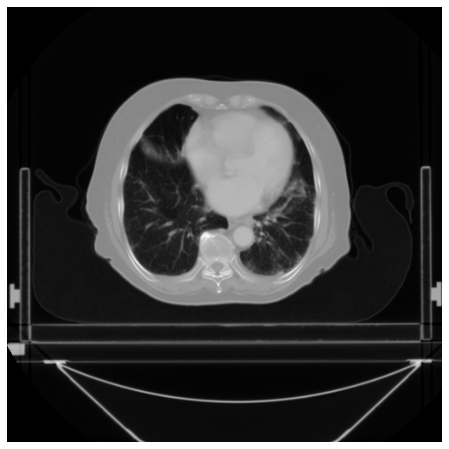

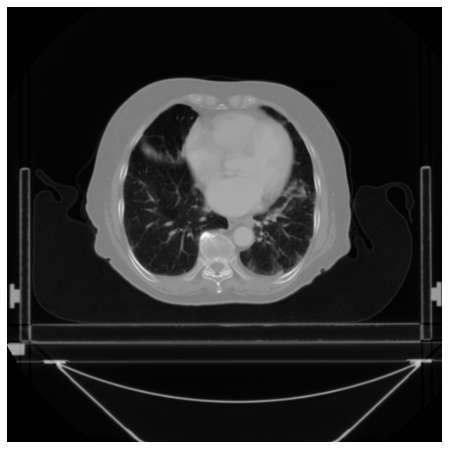

In [23]:
import time
path = '/staff/shijun/dataset/Med_Seg/Cervical_Oar/npy_data/190094.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Nasopharynx_Oar/npy_data/190510.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Covid-Seg/npy_data/0016.hdf5'
# path = '/acsa-med/radiology/Med_Seg/Lung_Oar/npy_data/190855.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Lung_Tumor/npy_data/01472680.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/EGFR/npy_data/0101.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/Lung_Tumor/npy_data/missing20/0009370744.hdf5'
# path = '/acsa-med/radiology/Med_Seg/LIDC/npy_data/LIDC-IDRI-0751.hdf5'
# path = '/staff/shijun/dataset/Med_Seg/LITS/npy_data/28.hdf5'
img = hdf5_reader(path,'image').astype(np.int32)
print(img.dtype)
s_time = time.time()
body = get_body(img)  #(-1000,600)
print('run time: %.3f'%(time.time()-s_time))
for i in range(img.shape[0]):
    draw_contour(img[i],body[i],1)

